# 1D linearized MHD with a uniform background magnetic field
This script simulates ideal MHD waves in a homogeneous plasma in a uniform background field $\textbf{B}_0=(B_{0x},B_{0y},B_{0z})$

Using the linearized ideal MHD equations with variations only in x-direction (the coordinate system is aligned with the direction of wave propagation, i.e. $\textbf{k}=k\textbf{e}_x$) one obtains a system for the perturbed quantities $\textbf{U}=(u_{1x},u_{1y},u_{1z},B_{1x},B_{1y},B_{1z},\rho_1,p_1)$ which can be written in the compact form

\begin{align}
\partial_t \textbf{U}(t,x)+A\partial_x\textbf{U}(t,x)=0,
\end{align}

with some initial condition $\textbf{U}(0,x)$ and appropriate boundary conditions.
The matrix $A$ is

\begin{align}
A=
\begin{pmatrix}
0 &0 &0 &0 &B_{0y}/\rho_0 &B_{0z}/\rho_0 &0 &1/(2\rho_0) \\
0 &0 &0 &0 &-B_{0x}/\rho_0 &0 &0 &0 \\
0 &0 &0 &0 &0 &-B_{0x}/\rho_0 &0 &0 \\
0 &0 &0 &0 &0 &0 &0 &0 \\
B_{0y} &-B_{0x} &0 &0 &0 &0 &0 &0 \\
B_{0z} &0 &-B_{0x} &0 &0 &0 &0 &0 \\
\rho_0 &0 &0 &0 &0 &0 &0 &0 \\
\gamma p_0 &0 &0 &0 &0 &0 &0 &0 
\end{pmatrix}.
\end{align}

The dispersion relation for this system reads

\begin{align}
\omega^2=\frac{1}{2}k^2(c_s^2+v_A^2)(1\pm\sqrt{1-\delta}),
\end{align}

where $c_s^2=\gamma p_0/2\rho_0$ is the speed of sound, $v_A^2=B_0^2/\rho_0$ is the Alfén-velocity and 

\begin{align}
\delta = \frac{4B_{0x}^2c_s^2v_A^2}{(c_s^2+v_A^2)^2B_0^2}.
\end{align}

number of time steps: 500
times steps finished: 0
times steps finished: 50
times steps finished: 100
times steps finished: 150
times steps finished: 200
times steps finished: 250
times steps finished: 300
times steps finished: 350
times steps finished: 400
times steps finished: 450
start to prepare animation!
number of frames: 125
frames finished: 0
frames finished: 50
frames finished: 100



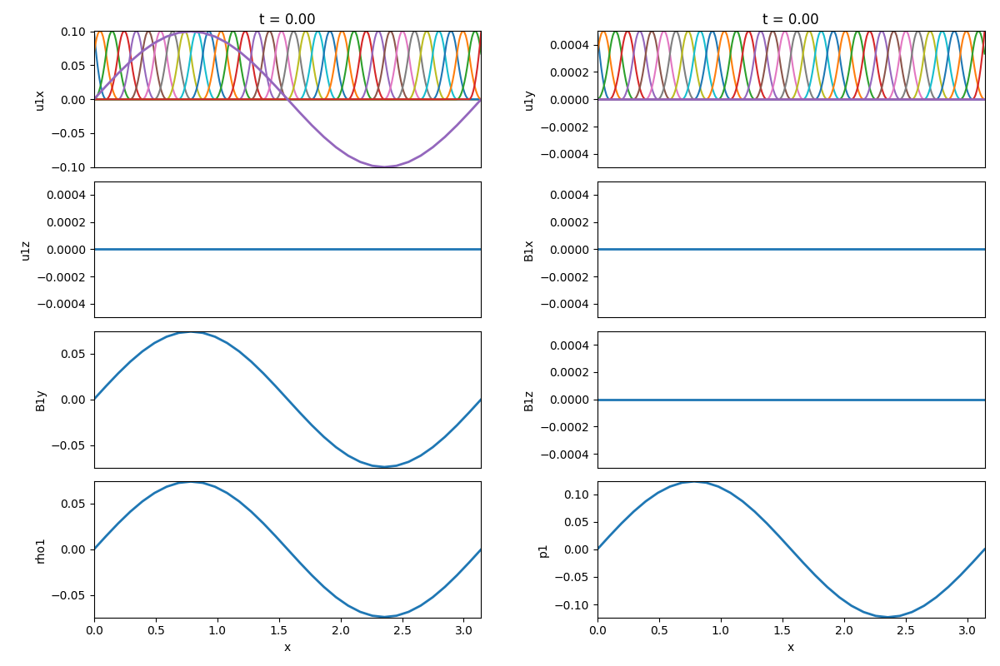
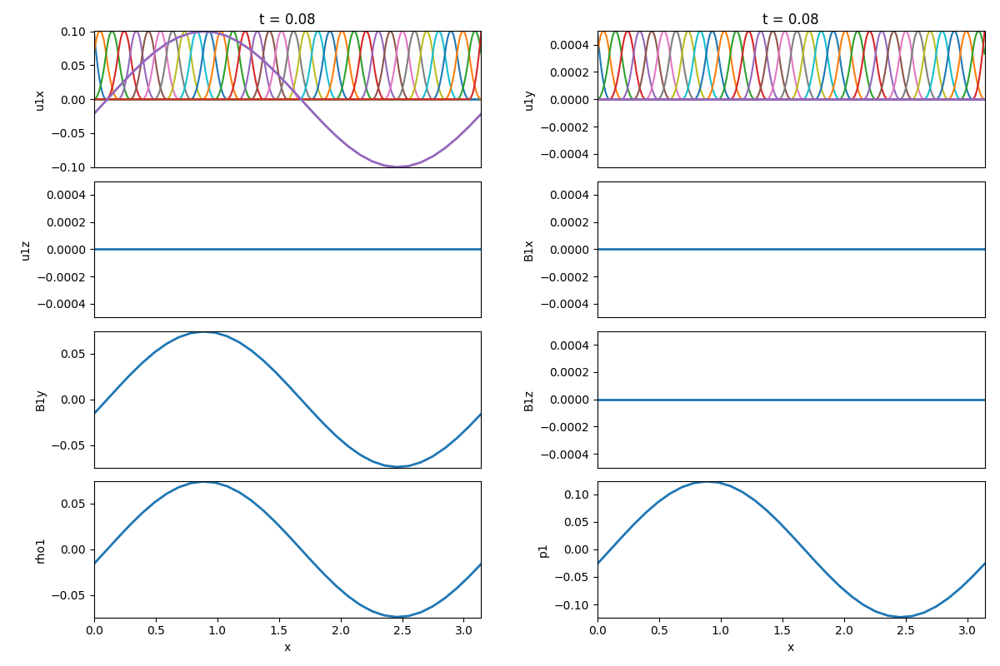
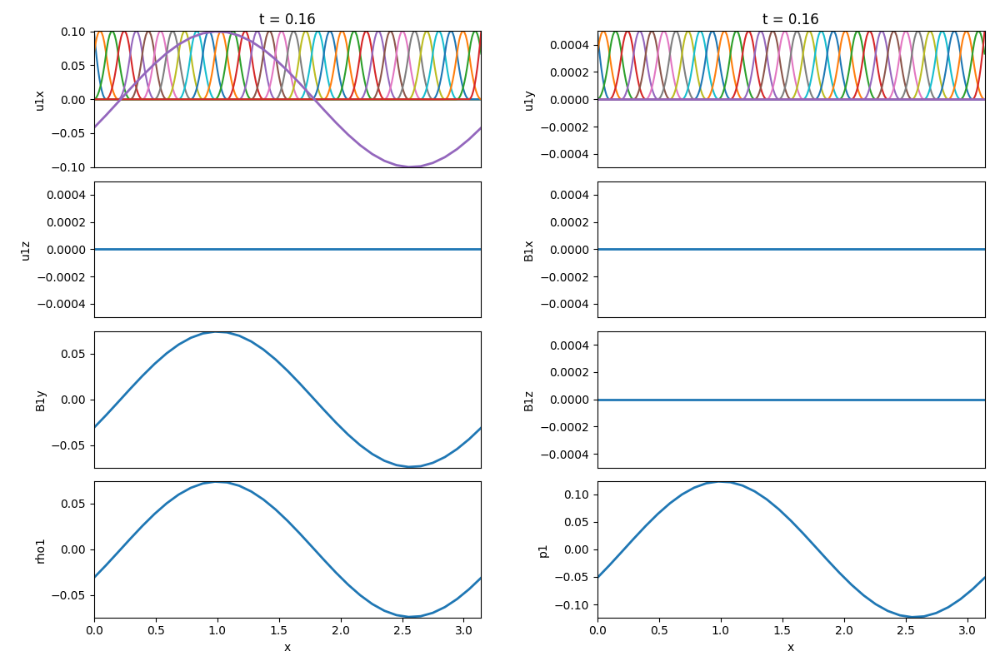
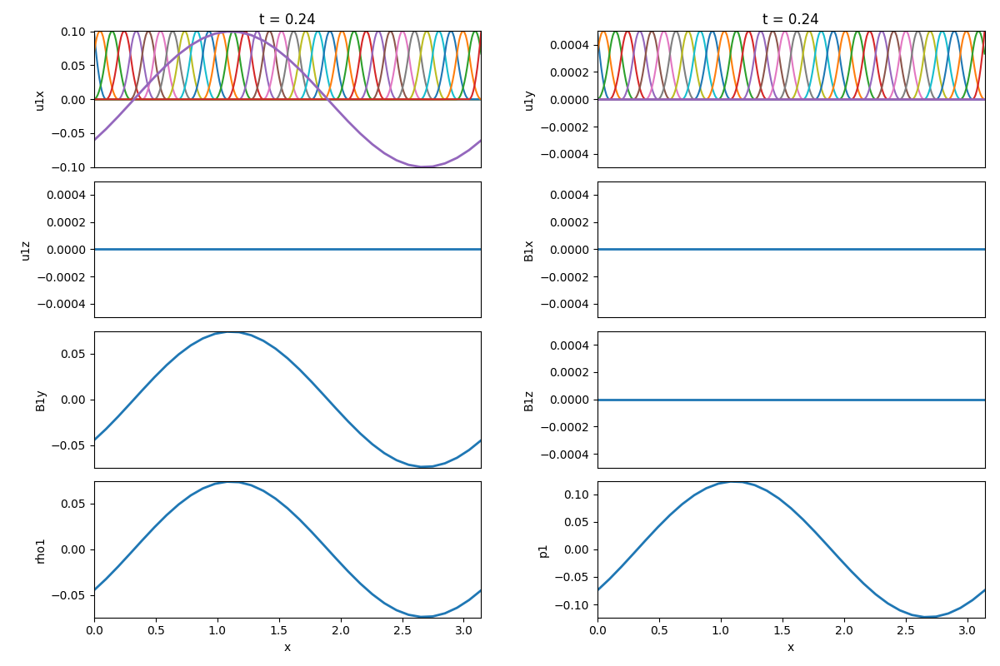
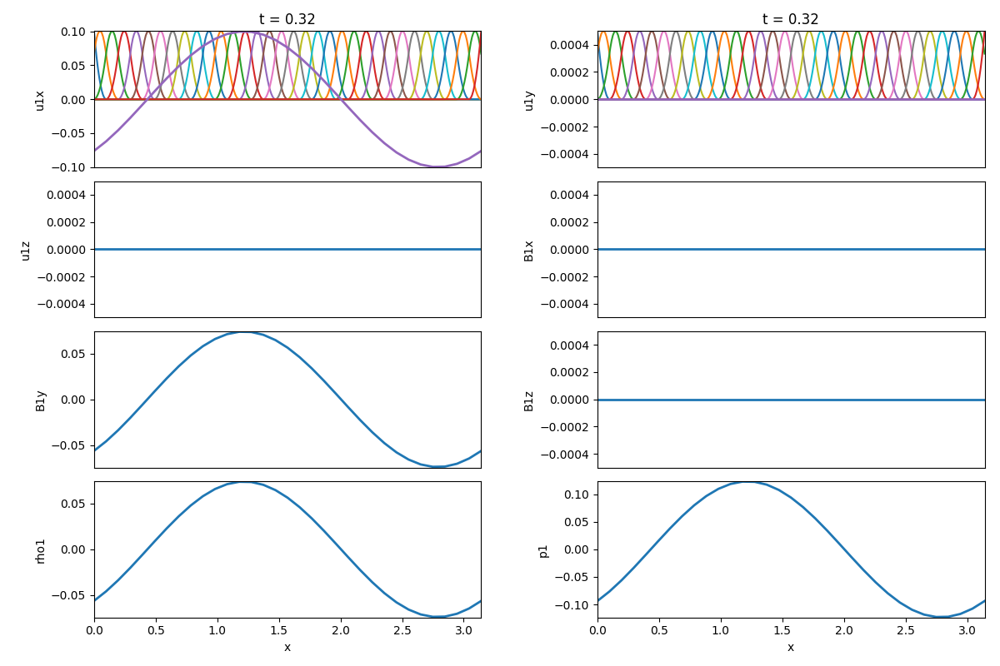
...
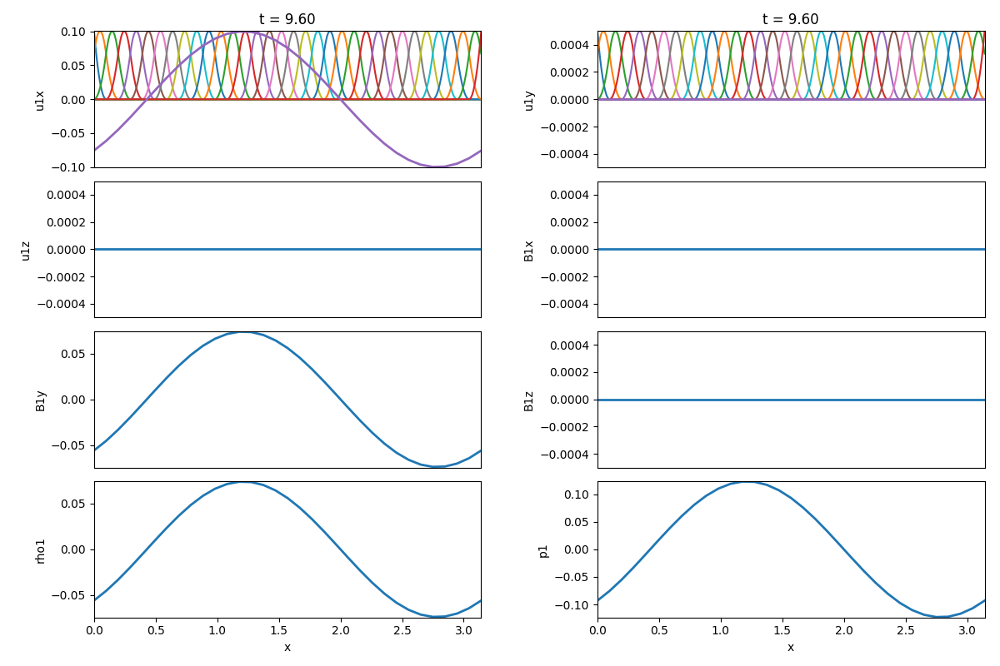
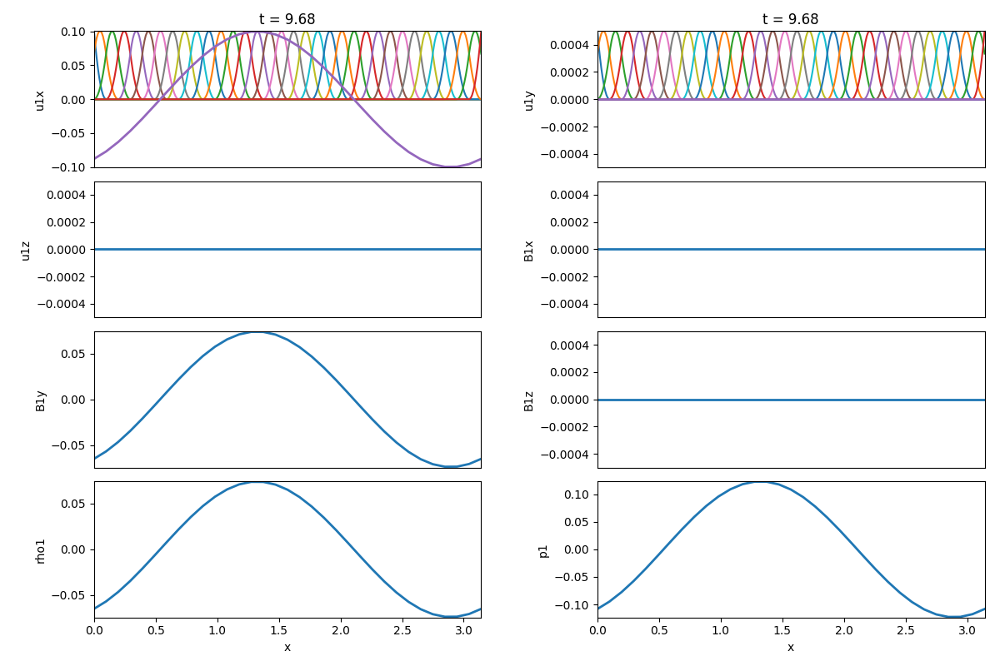
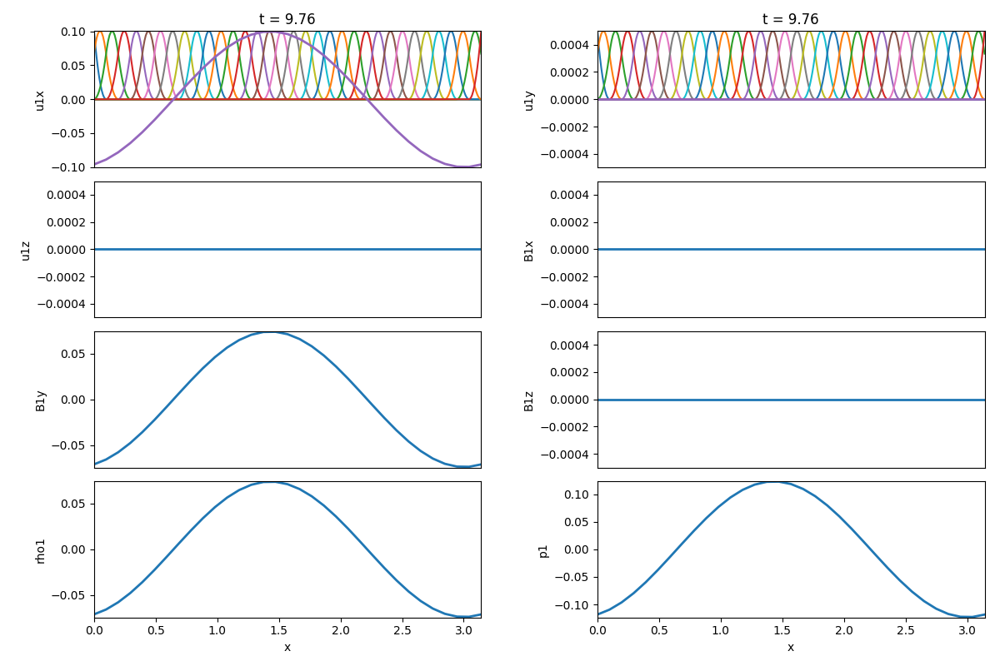
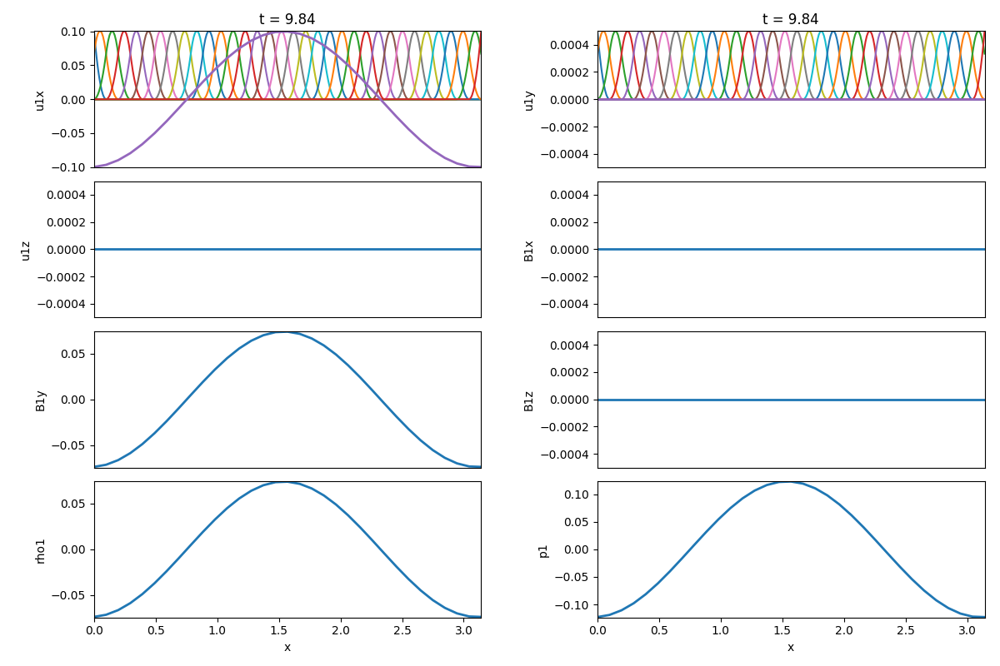
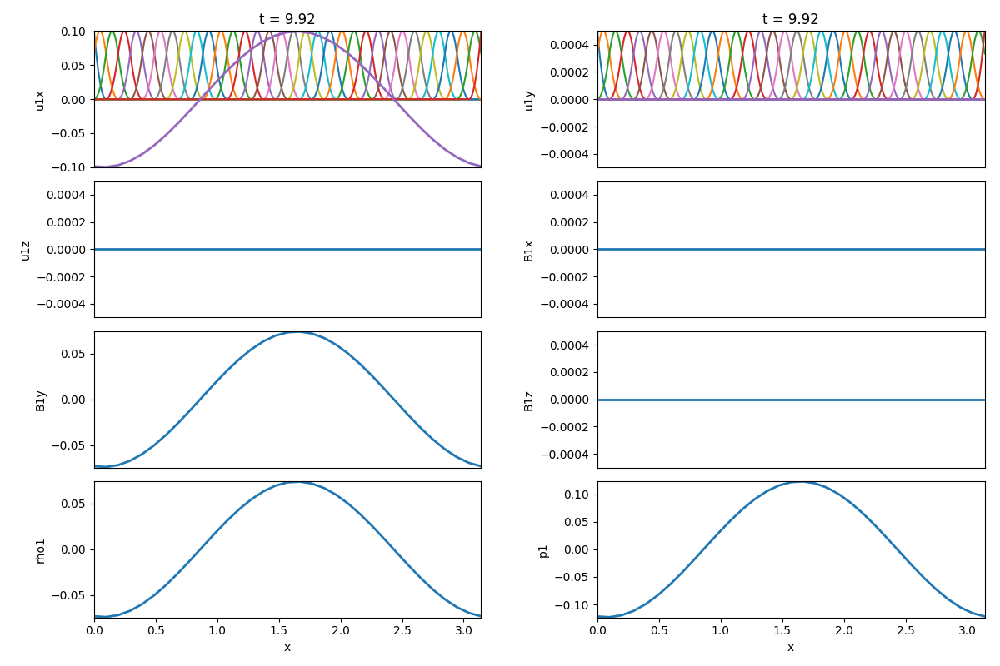

In [1]:
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
from JSAnimation import IPython_display
from matplotlib import animation
from scipy.linalg import block_diag
from numpy.linalg import inv
from bsplines import Bspline
from bsplines import CardinalBspline
from bsplines import UniformBspline



# ... physical input parameters
rho0 = 1                                           # ... eq. mass density of plasma
p0 = 1                                             # ... eq. pressure of plasma
B0x = 0                                            # ... background magnetic field in x-direction
B0y = 1                                            # ... background magnetic field in y-direction
B0z = 0                                            # ... background magnetic field in z-direction
gamma = 5/3                                        # ... adiabatic exponent
cs = np.sqrt(gamma*p0/(2*rho0))                    # ... speed of sound
vA = np.sqrt((B0x**2 + B0y**2 + B0z**2)/rho0)      # ... Alfvén-velocity
amp = 0.1                                          # ... characteristic amplitude of pertubations
T = 10                                             # ... simulation time
k = 2                                              # ... wavenumber of initial pertubation
Lx = 2*np.pi/k                                     # ... length of x-domain
# ...


# ... numerical input parameters
Nx = 32                                            # ... number of elements
dt = 0.02                                          # ... time step
p = 2                                              # ... degree of B-spline basis
q = p + 1                                          # ... number of quadratur points per element
theta = 0.5                                        # ... time integration scheme (1: implicit Euler, 0: explicit Euler, 0.5: Crank-Nicolson)
nx = 300                                           # ... number of x-points for plots 
showBsplines = 'on'                                # ... if you want to plot the B-spline basis put 'on' here
# ...



# ... input parameters for initial condition
ini = 'compressional-Alfvén'                       # ... define initial conditions (if 'arbitrary' you have to define the conditions manually)
# ...


# ... input parameters for animation 
fr = 4                                             # ... plot only every "fr-th" time step in animation (saves time)
# ...








# ... dispersion relation
def omega(k,pol):
    delta = (4*B0x**2*cs**2*vA**2)/((cs**2 + vA**2)**2*(B0x**2 + B0y**2 + B0z**2))
    return np.sqrt(1/2*k**2*(cs**2 + vA**2)*(1 + pol*np.sqrt(1 - delta)))
# ...

w = omega(k,+1)
vph = w/k





# ... initial conditions (put here the initial functions u(0,x))
def IC(x):
    if ini == 'shear-Alfvén': 
         
        u1x_0 = 0*x
        u1y_0 = amp*np.sin(k*x)
        u1z_0 = 0*x
        B1x_0 = 0*x
        B1y_0 = -k*B0x/w*u1y_0
        B1z_0 = 0*x
        rho1_0 = 0*x
        p1_0 = 0*x
        
        return np.array([u1x_0,u1y_0,u1z_0,B1x_0,B1y_0,B1z_0,rho1_0,p1_0])
    
    elif ini == 'compressional-Alfvén':
        
        u1x_0 = amp*np.sin(k*x)
        u1y_0 = 0*x
        u1z_0 = 0*x
        B1x_0 = 0*x
        B1y_0 = k*B0y/w*u1x_0
        B1z_0 = 0*x
        rho1_0 = k*rho0/w*u1x_0
        p1_0 = k*gamma*p0/w*u1x_0
        
        return np.array([u1x_0,u1y_0,u1z_0,B1x_0,B1y_0,B1z_0,rho1_0,p1_0])
    
    elif ini == 'sound-wave':
        
        u1x_0 = amp*np.sin(k*x)
        u1y_0 = 0*x
        u1z_0 = 0*x
        B1x_0 = 0*x
        B1y_0 = 0*x
        B1z_0 = 0*x
        rho1_0 = k*rho0/w*u1x_0
        p1_0 = k*gamma*p0/w*u1x_0
        
        return np.array([u1x_0,u1y_0,u1z_0,B1x_0,B1y_0,B1z_0,rho1_0,p1_0])
        
    elif ini == 'arbitrary':
        
        u1x_0 = 0*x
        u1y_0 = 0*x
        u1z_0 = 0*x
        B1x_0 = 0*x
        B1y_0 = amp*np.sin(k*x)
        B1z_0 = 0*x
        rho1_0 = 0*x
        p1_0 = 0*x
        
        return np.array([u1x_0,u1y_0,u1z_0,B1x_0,B1y_0,B1z_0,rho1_0,p1_0])
# ...  
    
    
    



# ... system matrix
A0 = np.array([0,0,0,0,B0y/rho0,B0z/rho0,0,1/(2*rho0)])
A1 = np.array([0,0,0,0,-B0x/rho0,0,0,0])                
A2 = np.array([0,0,0,0,0,-B0x/rho0,0,0])                
A3 = np.array([0,0,0,0,0,0,0,0])                
A4 = np.array([B0y,-B0x,0,0,0,0,0,0])                
A5 = np.array([B0z,0,-B0x,0,0,0,0,0])                
A6 = np.array([rho0,0,0,0,0,0,0,0])                
A7 = np.array([p0*gamma,0,0,0,0,0,0,0])              
A = np.array([A0,A1,A2,A3,A4,A5,A6,A7])

s = np.int(np.sqrt(A.size))
# ...



# ... discretisation of space and time
dx = Lx/Nx
CFL = vph*dt/dx
Nt = np.int(T/dt)
xj = np.linspace(0,Lx,Nx+1)
tn = np.linspace(0,T,Nt+1)
print('number of time steps: '+ str(Nt))    
# ...



# ... create B-spline basis and quadrature grid
left = np.linspace(-p*dx,-dx,p)
right = np.linspace(Lx+dx,Lx+p*dx,p)
Tbsp = np.array(list(left)  + list(xj) + list(right))
bsp = Bspline(Tbsp,p)
N = len(Tbsp) - p - 1
xi,wi = np.polynomial.legendre.leggauss(q)
quad_points = np.zeros(q*Nx)
weights = np.zeros(q*Nx)

for i in range(0,Nx):
    a1 = xj[i]
    a2 = xj[i+1]
    xis = (a2-a1)/2*xi + (a1+a2)/2
    quad_points[q*i:q*i+q] = xis
    wis = (a2-a1)/2*wi
    weights[q*i:q*i+q] = wis
# ...





# ... B-spline Finite Elements with notation U = (u1x,u1y,u1z,B1x,B1y,B1z,rho1,p1) and periodic boundary conditions   
def assembly():
    
    
    Nb = N - p                        # ... number of unique B-splines for periodic boundary conditions
    
    M = np.zeros((Nb,Nb))             # ... mass matrix
    Mblock = np.zeros((s*Nb,s*Nb))    # ... block mass matrix
    
    C = np.zeros((Nb,Nb))             # ... convection matrix
    Cblock = np.zeros((s*Nb,s*Nb))    # ... block convection matrix
    
    b0 = np.zeros((Nb,s))             # ... L2-projection of initial condition
    
    Ablock = block_diag(*([A]*Nb))    # ... block system matrix
    
    
    
    # ... assemble mass and convection matrices
    for ie in range(0,Nx):
        for il in range(0,p+1):
            for jl in range(0,p+1):

                i = il + ie  
                j = jl + ie

                value_m = 0.0
                value_c = 0.0

                for g in range(0,p+1):
                    gl = ie*(p+1) + g

                    value_m += weights[gl]*bsp(quad_points[gl],i,0)*bsp(quad_points[gl],j,0)
                    value_c += weights[gl]*bsp(quad_points[gl],i,0)*bsp(quad_points[gl],j,1)

                M[i%Nb,j%Nb] += value_m
                C[i%Nb,j%Nb] += value_c
    # ...


    # ... assemble b0
    for qu in range (0,s):
        for ie in range(0,Nx):
            for il in range(0,p+1):

                i = il + ie

                value_b = 0.0

                for g in range(0,p+1):
                    gl = ie*(p+1) + g

                    value_b += weights[gl]*IC(quad_points[gl])[qu]*bsp(quad_points[gl],i,0)

                b0[i%Nb,qu] += value_b
    # ...


    # ... L2-projection of initial conditions
    uini = np.dot(inv(M),b0)
    # ...


    # ... construct block mass and convection matrices
    for i in range(0,Nb):
        for j in range(0,Nb):
            l = s*i
            m = s*j
            Mblock[l:l+s,m:m+s] = np.identity(s)*M[i,j]
            Cblock[l:l+s,m:m+s] = np.identity(s)*C[i,j]
    # ...
    
    return Mblock,Cblock,Ablock,uini



Mblock,Cblock,Ablock,uini = assembly()
Nb = N - p




# ... time integration with theta method
uhj = np.zeros((Nt+1,s*Nb))
uhj[0,:] = np.reshape(uini,s*Nb)


LHS = Mblock + theta*dt*np.dot(Cblock,Ablock)
RHS = Mblock - (1-theta)*dt*np.dot(Cblock,Ablock) 
LHSinv = np.linalg.inv(LHS)

for n in range(0,Nt):
    
    if n%50 == 0:
        print('times steps finished: ' + str(n))
        
    uhj[n+1] = np.dot(np.dot(LHSinv,RHS),uhj[n])
    
uhj = np.reshape(uhj,(Nt+1,Nb,s))
# ...





# ... FEM result
def uh(tn,z,qu):
    u = 0
    for j in range(0,N):
        u += uhj[tn,j%Nb,qu]*bsp(z,j)
    return u

Test = np.zeros((Nt+1,Nx+1,s))

for qu in range(0,s):
    for n in range(0,Nt+1):
        Test[n,:,qu] = uh(n,xj,qu)
        
x_plot = np.linspace(0,Lx,nx)         
# ...

            





# ... animation
print('start to prepare animation!')
print('number of frames: ' + str(int(Nt/fr)))
f1, ((a1,a2),(a3,a4),(a5,a6),(a7,a8)) = plt.subplots(4,2,sharex = 'col')
f1.set_figheight(8)
f1.set_figwidth(12)
a1.set_title('t = 0.00')
a2.set_title('t = 0.00')
a1.set_xlim((0,Lx))
a2.set_xlim((0,Lx))
a3.set_xlim((0,Lx))
a4.set_xlim((0,Lx))
a5.set_xlim((0,Lx))
a6.set_xlim((0,Lx))
a7.set_xlim((0,Lx))
a8.set_xlim((0,Lx))
a1.set_ylim((np.min(Test[:,:,0]) - 0.0005,np.max(Test[:,:,0]) + 0.0005))
a2.set_ylim((np.min(Test[:,:,1]) - 0.0005,np.max(Test[:,:,1]) + 0.0005))
a3.set_ylim((np.min(Test[:,:,2]) - 0.0005,np.max(Test[:,:,2]) + 0.0005))
a4.set_ylim((np.min(Test[:,:,3]) - 0.0005,np.max(Test[:,:,3]) + 0.0005))
a5.set_ylim((np.min(Test[:,:,4]) - 0.0005,np.max(Test[:,:,4]) + 0.0005))
a6.set_ylim((np.min(Test[:,:,5]) - 0.0005,np.max(Test[:,:,5]) + 0.0005))
a7.set_ylim((np.min(Test[:,:,6]) - 0.0005,np.max(Test[:,:,6]) + 0.0005))
a8.set_ylim((np.min(Test[:,:,7]) - 0.0005,np.max(Test[:,:,7]) + 0.0005))
a1.set_ylabel('u1x')
a2.set_ylabel('u1y')
a3.set_ylabel('u1z')
a4.set_ylabel('B1x')
a5.set_ylabel('B1y')
a6.set_ylabel('B1z')
a7.set_ylabel('rho1')
a8.set_ylabel('p1')
a1.tick_params(axis = 'x',which = 'both',bottom = 'off',top = 'off',labelbottom = 'off') 
a2.tick_params(axis = 'x',which = 'both',bottom = 'off',top = 'off',labelbottom = 'off') 
a3.tick_params(axis = 'x',which = 'both',bottom = 'off',top = 'off',labelbottom = 'off') 
a4.tick_params(axis = 'x',which = 'both',bottom = 'off',top = 'off',labelbottom = 'off') 
a5.tick_params(axis = 'x',which = 'both',bottom = 'off',top = 'off',labelbottom = 'off') 
a6.tick_params(axis = 'x',which = 'both',bottom = 'off',top = 'off',labelbottom = 'off')

if showBsplines == 'on':
    y = np.zeros((N,nx),dtype = np.double)
    for i in range(0,N):
        y[i] = bsp(x_plot,i)
        a1.plot(x_plot,(np.max(Test[:,:,0]) + 0.0005)*y[i]/max(y[i]))
        a2.plot(x_plot,(np.max(Test[:,:,1]) + 0.0005)*y[i]/max(y[i]))

line1, = a1.plot([],[], lw=2)
line2, = a2.plot([],[], lw=2)
line3, = a3.plot([],[], lw=2)
line4, = a4.plot([],[], lw=2)
line5, = a5.plot([],[], lw=2)
line6, = a6.plot([],[], lw=2)
line7, = a7.plot([],[], lw=2)
line8, = a8.plot([],[], lw=2)
a7.set_xlabel('x')
a8.set_xlabel('x')
plt.tight_layout()
plt.subplots_adjust(wspace = 0.3, hspace = 0.1)

def init():  
    line1.set_data([], [])
    line2.set_data([], [])
    line3.set_data([], [])
    line4.set_data([], [])
    line5.set_data([], [])
    line6.set_data([], [])
    line7.set_data([], [])
    line8.set_data([], [])
    return line1,

def animate(i): 
    ti = int(fr*i)
    if i%50 == 0:
        print('frames finished: ' + str(i))
    line1.set_data(xj,Test[ti,:,0])
    line2.set_data(xj,Test[ti,:,1])
    line3.set_data(xj,Test[ti,:,2])
    line4.set_data(xj,Test[ti,:,3])
    line5.set_data(xj,Test[ti,:,4])
    line6.set_data(xj,Test[ti,:,5])
    line7.set_data(xj,Test[ti,:,6])
    line8.set_data(xj,Test[ti,:,7])
    a1.set_title('t = '+'%.2f' % tn[ti])
    a2.set_title('t = '+'%.2f' % tn[ti])
    return line1,

animation.FuncAnimation(f1, animate, init_func = init, frames = int(Nt/fr), interval = 50, blit = True)